<a href="https://colab.research.google.com/github/write-with-neurl/modelbit-notebooks/blob/main/Deploy_YoloV9_Model_With_Modelbit.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# ⚡ Deploying YoloV9 Model to A Rest API Endpoint for Object Detection

## 🧑‍💻 Installations and Set Up

To begin, we will clone an existing implementation of the YoloV9 research paper and install the required dependencies.

In [ ]:
!git clone https://github.com/SkalskiP/yolov9.git
%cd yolov9
!pip install -r requirements.txt -q

Cloning into 'yolov9'...
remote: Enumerating objects: 325, done.
remote: Counting objects: 100% (202/202), done.
remote: Compressing objects: 100% (84/84), done.
remote: Total 325 (delta 152), reused 118 (delta 118), pack-reused 123
Receiving objects: 100% (325/325), 2.26 MiB | 13.96 MiB/s, done.
Resolving deltas: 100% (161/161), done.
/content/yolov9
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 195.4/195.4 kB 3.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 62.7/62.7 kB 6.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.6/1.6 MB 17.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 23.7/23.7 MB 46.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 823.6/823.6 kB 43.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 14.1/14.1 MB 60.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 731.7/731.7 MB 2.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 410.6/410.6 MB 3.8 MB/s eta 0:00

In [ ]:
!pip install modelbit

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 128.0/128.0 kB 2.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.1/2.1 MB 17.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 5.4/5.4 MB 39.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 139.3/139.3 kB 16.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 143.8/143.8 kB 17.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 12.1/12.1 MB 46.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 82.2/82.2 kB 9.9 MB/s eta 0:00:00
INFO: pip is looking at multiple versions of types-requests to determine which version is compatible with other requirements. This could take a while.
INFO: pip is looking at multiple versions of types-requests to determine which version is compatible with other requirements. This could take a while.
  Attempting uninstall: urllib3
    Found existing installation: urllib3 2.0.7
    Uninstalling urllib3-2.0.7:
      Successfully u

In [ ]:
!pip install supervision

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 97.1/97.1 kB 2.9 MB/s eta 0:00:00


In [ ]:
# Getting the current working directory, where the notebook is running and assign that directory to HOME variable

import os
HOME = os.getcwd()
print(HOME)

/content/yolov9


### 📥 Downloading YoloV9 weights


The repository contains pre-trained weight files for different configurations (`yolov9-c.pt`, `yolov9-e.pt`, `gelan-c.pt`, `gelan-e.pt`) of the YOLOv9 object detection model and its components. These weights are crucial for the model's ability to detect objects in images or videos.

Let's break down what each of these weights represents:
- `yolov9-c.pt`: This weight file is designed for a balance between speed and accuracy. The "c" in the filename denotes a variant within the YOLOv9 model family, focusing on computational efficiency or a compact model size.

- `yolov9-e.pt`: The "e" in the filename denotes it is "enhanced" or "extended" version, offering higher accuracy. It is larger in size and requires more computational resources compared to other variants like yolov9-c.pt.

- `gelan-c.pt` and `gelan-e.pt`: These weights are associated with the [GELAN](https://arxiv.org/pdf/2211.04800.pdf) (Generalized Efficient Layer Aggregation Network) architecture, which is part of the innovations introduced in YOLOv9. GELAN is designed to optimize parameter efficiency and improve the model's performance. The "c" and "e" in the filenames indicate different versions of the GELAN architecture, with each tailored for specific use cases or performance criteria. "c" is aimed at computational efficiency, while "e" aimed at enhancing performance.

In [ ]:
!wget -P {HOME}/weights -q https://github.com/WongKinYiu/yolov9/releases/download/v0.1/yolov9-c.pt
!wget -P {HOME}/weights -q https://github.com/WongKinYiu/yolov9/releases/download/v0.1/yolov9-e.pt
!wget -P {HOME}/weights -q https://github.com/WongKinYiu/yolov9/releases/download/v0.1/gelan-c.pt
!wget -P {HOME}/weights -q https://github.com/WongKinYiu/yolov9/releases/download/v0.1/gelan-e.pt

In [ ]:
!ls -la {HOME}/weights

total 402448
drwxr-xr-x  2 root root      4096 Mar 30 11:14 .
drwxr-xr-x 12 root root      4096 Mar 30 11:14 ..
-rw-r--r--  1 root root  51508261 Feb 18 12:36 gelan-c.pt
-rw-r--r--  1 root root 117203713 Feb 18 12:36 gelan-e.pt
-rw-r--r--  1 root root 103153312 Feb 18 12:36 yolov9-c.pt
-rw-r--r--  1 root root 140217688 Feb 18 12:36 yolov9-e.pt


In [ ]:
!pwd

/content/yolov9


### 🖼️ Downloading Sample Data

In [ ]:
!wget -P {HOME}/data -q https://doc.modelbit.com/img/cat.jpg
!wget -P {HOME}/data -q http://doc.modelbit.com/img/dog-in-snow.jpg

## Detection with pre-trained COCO model

### Detection with the computationally efficient `yolov9-c` weight

In [ ]:
!python detect.py --weights {HOME}/weights/yolov9-c.pt --conf 0.1 --source {HOME}/data/cat.jpg --device cpu

detect: weights=['/content/yolov9/weights/yolov9-c.pt'], source=/content/yolov9/data/cat.jpg, data=data/coco128.yaml, imgsz=[640, 640], conf_thres=0.1, iou_thres=0.45, max_det=1000, device=cpu, view_img=False, save_txt=False, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=runs/detect, name=exp, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False, vid_stride=1
YOLOv5 🚀 1e33dbb Python-3.10.12 torch-2.2.1+cu121 CPU

Fusing layers... 
Model summary: 724 layers, 51141120 parameters, 0 gradients, 238.7 GFLOPs
image 1/1 /content/yolov9/data/cat.jpg: 480x640 1 cat, 1 dog, 2 chairs, 2 couchs, 1 potted plant, 1 bed, 2839.5ms
Speed: 2.0ms pre-process, 2839.5ms inference, 30.2ms NMS per image at shape (1, 3, 640, 640)
Results saved to runs/detect/exp


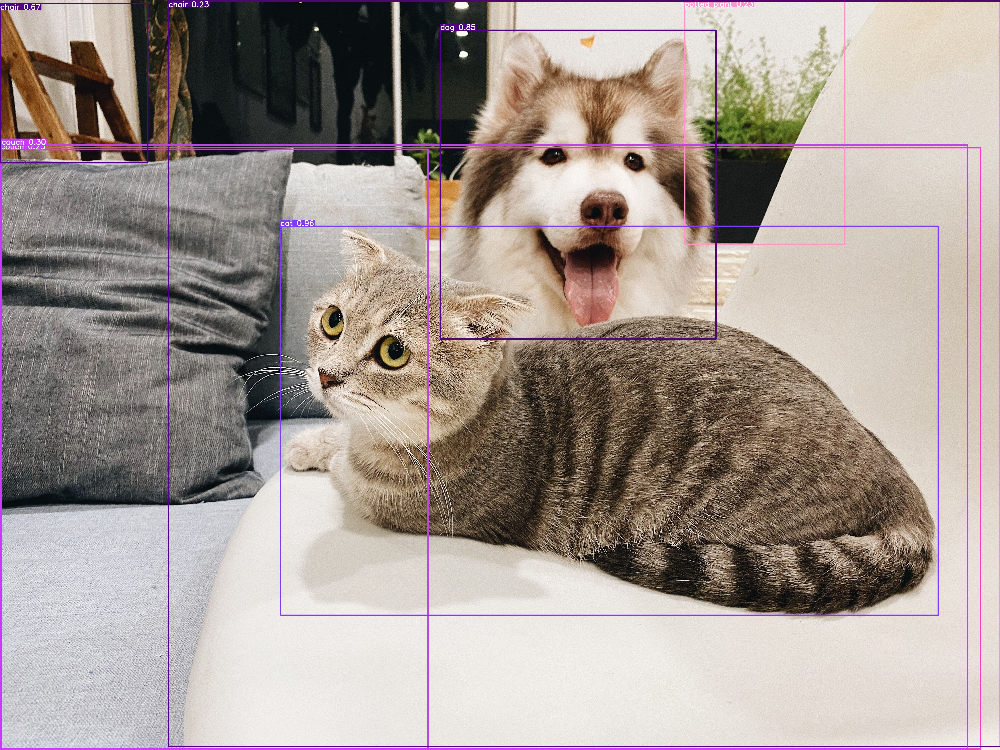

In [ ]:
from IPython.display import Image

Image(filename=f"{HOME}/runs/detect/exp/cat.jpg", width=600)

In [ ]:
!python detect.py --weights {HOME}/weights/yolov9-c.pt --conf 0.1 --source {HOME}/data/dog-in-snow.jpg --device cpu

detect: weights=['/content/yolov9/weights/yolov9-c.pt'], source=/content/yolov9/data/dog-in-snow.jpg, data=data/coco128.yaml, imgsz=[640, 640], conf_thres=0.1, iou_thres=0.45, max_det=1000, device=cpu, view_img=False, save_txt=False, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=runs/detect, name=exp, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False, vid_stride=1
YOLOv5 🚀 1e33dbb Python-3.10.12 torch-2.2.1+cu121 CPU

Fusing layers... 
Model summary: 724 layers, 51141120 parameters, 0 gradients, 238.7 GFLOPs
image 1/1 /content/yolov9/data/dog-in-snow.jpg: 448x640 1 person, 1 dog, 1 handbag, 2572.5ms
Speed: 2.3ms pre-process, 2572.5ms inference, 1.5ms NMS per image at shape (1, 3, 640, 640)
Results saved to runs/detect/exp2


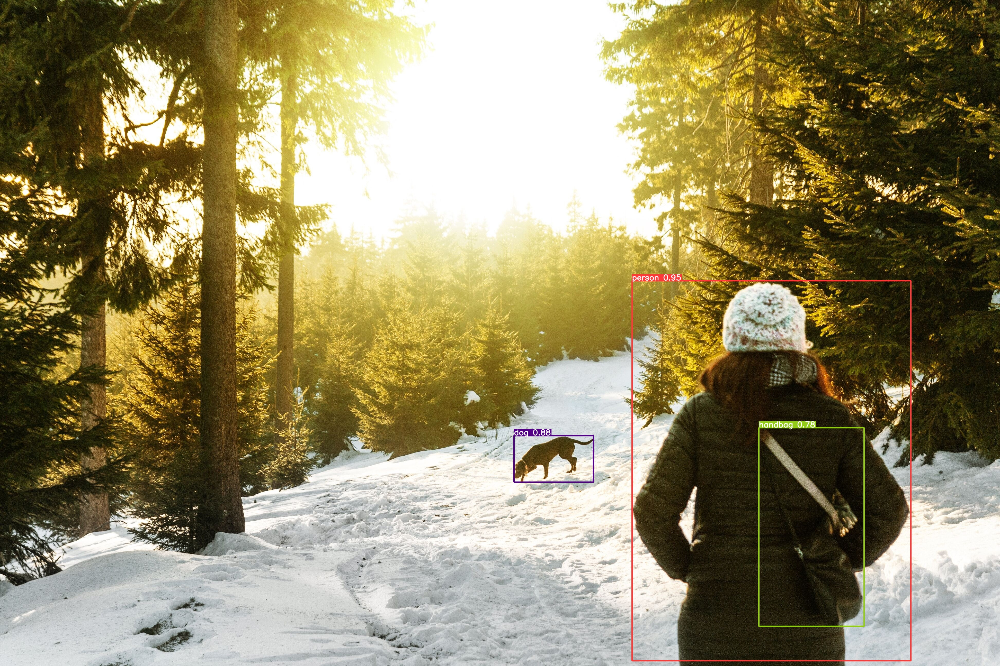

In [ ]:
from IPython.display import Image

Image(filename=f"{HOME}/runs/detect/exp2/dog-in-snow.jpg", width=600)

### Detection with the computationally efficient `gelan-c` weight

In [ ]:
!python detect.py --weights {HOME}/weights/gelan-c.pt --conf 0.1 --source {HOME}/data/cat.jpg --device cpu

detect: weights=['/content/yolov9/weights/gelan-c.pt'], source=/content/yolov9/data/cat.jpg, data=data/coco128.yaml, imgsz=[640, 640], conf_thres=0.1, iou_thres=0.45, max_det=1000, device=cpu, view_img=False, save_txt=False, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=runs/detect, name=exp, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False, vid_stride=1
YOLOv5 🚀 1e33dbb Python-3.10.12 torch-2.2.1+cu121 CPU

Fusing layers... 
Model summary: 467 layers, 25472640 parameters, 0 gradients, 102.8 GFLOPs
image 1/1 /content/yolov9/data/cat.jpg: 480x640 1 cat, 1 dog, 2 chairs, 1 couch, 1581.7ms
Speed: 1.9ms pre-process, 1581.7ms inference, 2.0ms NMS per image at shape (1, 3, 640, 640)
Results saved to runs/detect/exp3


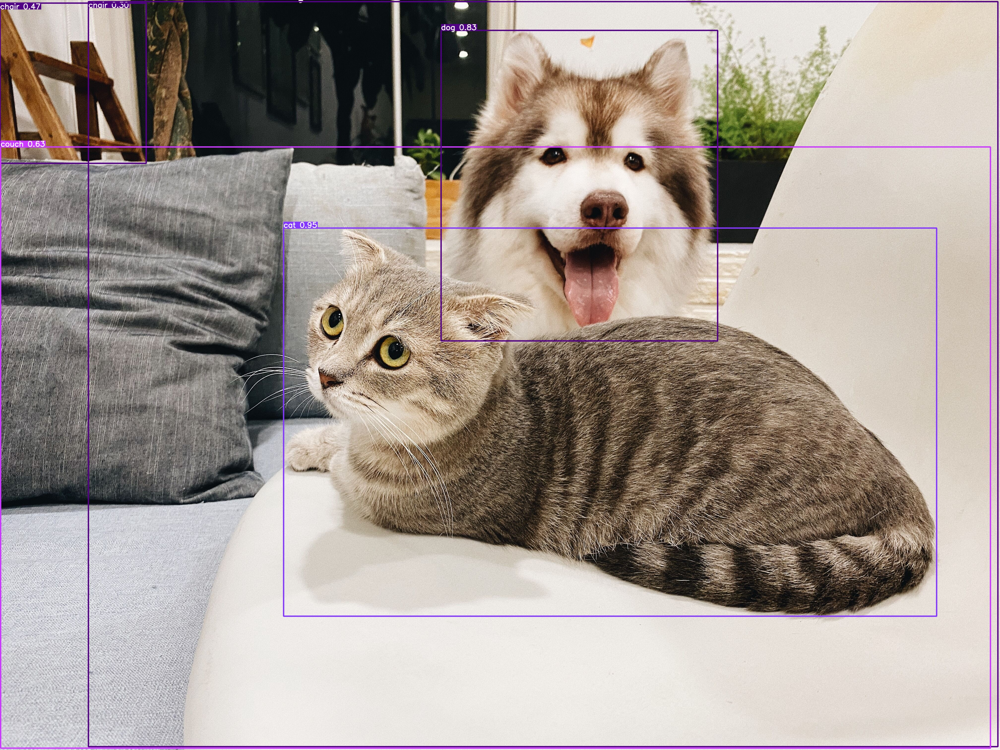

In [ ]:
from IPython.display import Image

Image(filename=f"{HOME}/runs/detect/exp3/cat.jpg", width=600)

In [ ]:
!python detect.py --weights {HOME}/weights/gelan-c.pt --conf 0.1 --source {HOME}/data/dog-in-snow.jpg --device cpu

detect: weights=['/content/yolov9/weights/gelan-c.pt'], source=/content/yolov9/data/dog-in-snow.jpg, data=data/coco128.yaml, imgsz=[640, 640], conf_thres=0.1, iou_thres=0.45, max_det=1000, device=cpu, view_img=False, save_txt=False, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=runs/detect, name=exp, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False, vid_stride=1
YOLOv5 🚀 1e33dbb Python-3.10.12 torch-2.2.1+cu121 CPU

Fusing layers... 
Model summary: 467 layers, 25472640 parameters, 0 gradients, 102.8 GFLOPs
image 1/1 /content/yolov9/data/dog-in-snow.jpg: 448x640 1 person, 1 dog, 1 handbag, 1302.7ms
Speed: 2.4ms pre-process, 1302.7ms inference, 1.7ms NMS per image at shape (1, 3, 640, 640)
Results saved to runs/detect/exp4


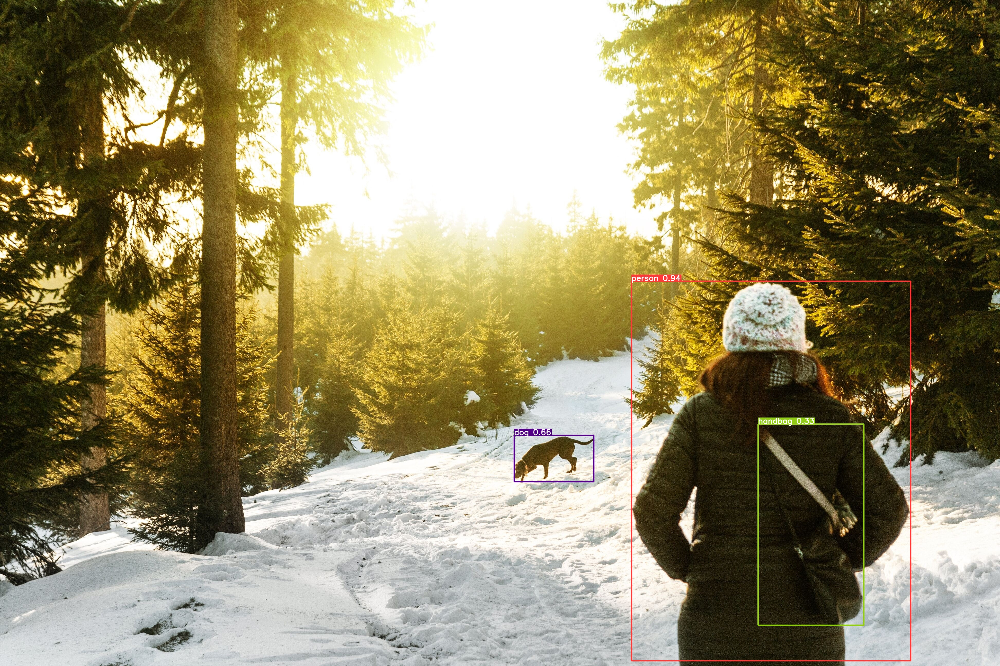

In [ ]:
from IPython.display import Image

Image(filename=f"{HOME}/runs/detect/exp4/dog-in-snow.jpg", width=600)

### Model Weight of choice

In our deployment, we would choose to deploy the model weight that is more computationally efficient. From the code cells above, you can observe that the `gelan-c.pt` model has a much faster inference time compared to `yolov9-c.pt`. Therefore, in this tutorial, we would deploy `gelan-c.pt` as it offers better computational efficiency.

## Inference Function for Object detection

The function begins by initializing the device and loading the pre-trained object detection model. It then downloads the image from the provided URL, preprocesses it by resizing and normalizing the pixel values, and converts it to a PyTorch tensor. This tensor is passed through the loaded model, and the resulting predictions are filtered using non-maximum suppression. For each remaining detection, the script scales the bounding box coordinates to match the original image dimensions, creates a Detections object from the Supervision library, and generates labels by combining the class IDs and confidence scores. Finally, it prints the generated labels to the console and returns them as a list.

In [ ]:
import torch
import cv2
import numpy as np
from models.common import DetectMultiBackend
from utils.general import non_max_suppression, scale_boxes
from utils.torch_utils import select_device, smart_inference_mode
from utils.augmentations import letterbox
from PIL import Image
import supervision as sv
import requests

@smart_inference_mode()
def generate_labels(image_url, weights='weights/gelan-c.pt', imgsz=640, conf_thres=0.1, iou_thres=0.45, device='cpu', data='data/coco.yaml'):
    # Initialize
    device = select_device(device)
    model = DetectMultiBackend(weights, device=device, fp16=False, data=data)
    stride, names, pt = model.stride, model.names, model.pt

    # Load image
    image = Image.open(requests.get(image_url, stream=True).raw)
    img0 = np.array(image)
    assert img0 is not None, f'Image Not Found {image_url}'
    img = letterbox(img0, imgsz, stride=stride, auto=True)[0]
    img = img[:, :, ::-1].transpose(2, 0, 1)
    img = np.ascontiguousarray(img)
    img = torch.from_numpy(img).to(device).float()
    img /= 255.0
    if img.ndimension() == 3:
        img = img.unsqueeze(0)

    # Inference
    pred = model(img, augment=False, visualize=False)

    # Apply NMS
    pred = non_max_suppression(pred[0][0], conf_thres, iou_thres, classes=None, max_det=1000)

    # Process detections
    for i, det in enumerate(pred):
        if len(det):
          det[:, :4] = scale_boxes(img.shape[2:], det[:, :4], img0.shape).round()
          for *xyxy, conf, cls in reversed(det):
            # Transform detections to supervisions detections
            detections = sv.Detections(
                xyxy=torch.stack(xyxy).cpu().numpy().reshape(1, -1),
                class_id=np.array([int(cls)]),
                confidence=np.array([float(conf)])
              )
              # Labels
            labels = [f"{class_id} {confidence:0.2f}"
                    for class_id, confidence
                    in zip(detections.class_id, detections.confidence)
                    ]
            print(labels)
    return labels

In [ ]:
labels = generate_labels(image_url='https://doc.modelbit.com/img/cat.jpg')
labels

YOLOv5 🚀 1e33dbb Python-3.10.12 torch-2.2.1+cu121 CPU

Fusing layers... 
Model summary: 467 layers, 25472640 parameters, 0 gradients, 102.8 GFLOPs


['3595 633.48']
['4727 477.04']
['6103 644.80']
['6109 476.15']
['6186 0.71']
['5140 0.81']
['6162 0.32']
['6123 0.42']


['6123 0.42']

## 🚢 Deploy YoloV9 with GELAN compact pre-trained weights `gelan-c.pt` to a REST API Endpoint

### 🔐 Log into `modelbit`

In [ ]:
import modelbit as mb

mb.login()

<module 'modelbit' from '/usr/local/lib/python3.10/dist-packages/modelbit/__init__.py'>

Now in this deployment we include the cloned repository and pre-trained weight of choice

In [ ]:
mb.deploy(generate_labels,
          python_packages=[
                          "matplotlib==3.7.1",
                          "numpy==1.25.2",
                          "torch==2.0.1+cpu",
                          "torchvision==0.15.2+cpu",
                          "opencv-python==4.8.0.76",
                          "supervision==0.19.0",
                          "Pillow==9.4.0"],
          system_packages=["python3-opencv"],
          extra_files=["weights/gelan-c.pt","data/coco.yaml",
          "models", "utils", "export.py"]
          )

## 📩 Test the REST Endpoint with a Single Image

You can test your REST Endpoint by [sending single or batch production images](https://doc.modelbit.com/deployments/rest-api/single-inference) to it for scoring.

Use the `requests` package to POST a request to the API and use `json` to format the response to print nicely:


> ⚠️ Replace the `ENTER_WORKSPACE_NAME` placeholder with your workspace name.

In [ ]:
import json
import requests

requests.post("https://ENTER_WORKSPACE_NAME.us-east-1.modelbit.com/v1/generate_labels/latest",
              headers={"Content-Type":"application/json"},
              data=json.dumps({"data": ["https://doc.modelbit.com/img/cat.jpg"]})).json()

{'data': ['6123 0.42']}

You can also test your endpoint from the command line using:


> `curl -s -XPOST "https://ENTER_WORKSPACE_NAME.us-east-1.modelbit.com/v1/generate_labels/latest" -d '{"data": ["https://doc.modelbit.com/img/cat.jpg"]}' | json_pp`

---
> ⚠️ Replace the `ENTER_WORKSPACE_NAME` placeholder with your workspace name.